**Importing Required Libraries**

In [1]:
import pandas as  pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
%matplotlib notebook
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from IPython.display import HTML
import calendar
from plotly.subplots import make_subplots
pd.set_option('display.max_columns', None)
pd.set_option('display.max_row', None)
import plotly as py
import plotly.graph_objs as go
from plotly.offline import iplot, init_notebook_mode
import  matplotlib.pyplot as plt
plt.style.use('fivethirtyeight')

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
df = pd.read_csv(r'/content/drive/MyDrive/AC_Data.csv')

In [4]:
df['0'] = pd.to_datetime(df['0'])

In [5]:
df.shape

(87840, 19)

**Cleaning the Data**

In [6]:
df.isnull().sum()

0            0
AC 1     44132
AC 2     44129
AC 3     44127
AC 4     44136
AC 5     44124
AC 6     44123
AC 7     44161
AC 8     44136
AC 9     44186
AC 10    44150
AC 11    44170
AC 12    44127
AC 13    44121
AC 14    44144
AC 15    44125
AC 16    44130
AC 17    44126
AC 18    44117
dtype: int64

In [7]:
#GETTING ROW WITH NULL VALUES LESS THAN 18 NOS.
df1 = df[df.isnull().sum(axis=1) < 18]

In [8]:
df1.shape

(51979, 19)

In [9]:
df1.head()

,0,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18
0,2019-08-01 00:00:00,7.518632,8.788315,0.0,0.0,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981
2,2019-08-01 00:02:00,7.426114,8.940615,0.0,0.0,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500
4,2019-08-01 00:04:00,7.052986,9.161103,0.0,0.0,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475
6,2019-08-01 00:06:00,6.665446,9.065626,0.0,0.0,2.575639,3.772891,2.596200,5.805132,3.553778,1.878356,2.737645,2.510972,3.090007,2.666604,4.607439,3.062610,3.063953,6.127366
8,2019-08-01 00:08:00,6.674838,9.096130,0.0,0.0,2.021472,3.155697,2.845417,6.315060,3.042244,1.914650,2.452500,2.171791,3.097202,2.710572,5.332696,2.640150,2.864680,5.662474


In [10]:
#pip install plotly

In [11]:
df2 = df1.copy()

In [12]:
#df2['0'] = pd.to_datetime(df2['0'])

In [13]:
#df2['0']

In [14]:
df2['hour'] = df2['0'].dt.hour
df2['year'] = df2['0'].dt.year
df2['month'] = df2['0'].dt.month
df2['day'] = df2['0'].dt.day

In [15]:
# df2['Dates'] = pd.to_datetime(df2['0'], format='%Y:%M:%D').dt.date
# df2['Hours'] = pd.to_datetime(df2['0'], format='%Y:%M:%D').dt.time

In [16]:
#df2.drop(['0'],axis=1,inplace=True)

In [17]:
#Filtering the data having null values
is_NaN = df2.isnull()
row_has_NaN = is_NaN.any(axis=1)
rows_with_NaN = df2[row_has_NaN]

In [18]:
#Data having null values
rows_with_NaN.head()

,0,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,hour,year,month,day
16,2019-08-01 00:16:00,6.516551,9.109929,1.889499,2.757944,0.689412,3.453630,2.887650,4.672470,3.111866,2.427951,1.864480,2.500571,NaN,5.227915,6.336356,3.559191,3.524848,6.375438,0,2019,8,1
552,2019-08-01 09:12:00,2.707303,6.856526,2.543368,3.181094,1.523996,4.054890,2.206584,2.635548,NaN,2.139787,2.351480,1.371908,4.792412,1.404612,4.591492,4.492302,4.721137,9.252911,9,2019,8,1
558,2019-08-01 09:18:00,2.468894,6.727608,2.004303,2.911885,1.485278,2.289360,2.524484,NaN,2.304222,1.550789,2.237994,3.189787,8.715295,3.221818,4.566595,3.853367,4.746631,9.280914,9,2019,8,1
566,2019-08-01 09:26:00,1.175999,7.180055,2.225312,2.938088,NaN,2.260625,2.226880,2.926143,2.509075,1.212484,1.176627,0.000000,7.451234,3.943130,2.670249,3.814476,4.935750,9.624206,9,2019,8,1
612,2019-08-01 10:12:00,1.852034,8.469838,1.671481,1.655041,1.136528,0.000000,2.962280,3.903255,NaN,1.410805,0.000000,3.281935,3.281430,1.391831,3.711380,2.811551,4.947807,9.627031,10,2019,8,1


In [19]:
df2.describe().T

,count,mean,std,min,25%,50%,75%,max
AC 1,43708.0,2.379368,2.276782,0.0,0.000000,2.094330,3.661752,11.194789
AC 2,43711.0,3.868892,2.545147,0.0,2.123263,3.791752,5.460892,11.147141
AC 3,43713.0,2.568411,1.487508,0.0,1.706508,2.486992,3.441527,8.430909
AC 4,43704.0,2.395158,1.797529,0.0,1.258299,2.308961,3.476123,9.879500
AC 5,43716.0,1.421699,0.767218,0.0,0.970744,1.380183,1.870234,5.495358
AC 6,43717.0,2.518138,1.655560,0.0,1.543779,2.665063,3.616988,9.929291
AC 7,43679.0,2.980883,1.473498,0.0,2.190803,3.005071,3.897857,9.356776
AC 8,43704.0,2.548711,1.504482,0.0,1.766230,2.608551,3.496358,9.331506
AC 9,43654.0,3.184382,1.522291,0.0,2.294635,3.082134,4.096374,10.026747
AC 10,43690.0,1.538344,0.685461,0.0,1.117139,1.504554,1.963707,4.625030


**Filling the  null values with mean value**

In [20]:
df2.fillna(df2.mean(),inplace=True)

In [21]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 51979 entries, 0 to 87839
Data columns (total 23 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   0       51979 non-null  datetime64[ns]
 1   AC 1    51979 non-null  float64       
 2   AC 2    51979 non-null  float64       
 3   AC 3    51979 non-null  float64       
 4   AC 4    51979 non-null  float64       
 5   AC 5    51979 non-null  float64       
 6   AC 6    51979 non-null  float64       
 7   AC 7    51979 non-null  float64       
 8   AC 8    51979 non-null  float64       
 9   AC 9    51979 non-null  float64       
 10  AC 10   51979 non-null  float64       
 11  AC 11   51979 non-null  float64       
 12  AC 12   51979 non-null  float64       
 13  AC 13   51979 non-null  float64       
 14  AC 14   51979 non-null  float64       
 15  AC 15   51979 non-null  float64       
 16  AC 16   51979 non-null  float64       
 17  AC 17   51979 non-null  float64       
 18  AC 18 

**No null value present in the data and  the data type  of Date column changed(datetime64[ns])**

In [22]:
#df2['Dates']= pd.to_datetime(df2['Dates'])

In [23]:
#df2['Hours']= pd.to_datetime(df2['Hours'])

In [24]:
#df2['Hours'].dt.hour

In [25]:
# # data cleaning 
# d['Total']=data.sum(axis=1)
# data.loc['Total']=data.sum()
# Total_comsumes=data.iloc[[-1]]
# Total=Total_comsumes.transpose()
# Total.drop(Total.index[[-1]], inplace=True)
# Total.reset_index(inplace=True)
# Total.rename(columns={'index':'State'}, inplace=True)

In [26]:
df3 = df2.copy()

In [27]:
df3.reset_index(drop=True,inplace=True)

In [28]:
df3 = df2[['AC 1', 'AC 2', 'AC 3', 'AC 4', 'AC 5', 'AC 6', 'AC 7', 'AC 8',
       'AC 9', 'AC 10', 'AC 11', 'AC 12', 'AC 13', 'AC 14', 'AC 15', 'AC 16',
       'AC 17', 'AC 18']]

In [29]:
df3['Total_row']=df3.sum(axis=1)
df3.loc['Total_col']=df3.sum()

In [30]:
Total_comsumes=df3.iloc[[-1]]
Total_comsumes

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,Total_row
Total_col,123677.176949,201101.148844,133503.443691,124497.941513,73898.509168,130890.286742,154943.342182,132479.437975,165521.006581,79961.557345,125068.818068,140324.51345,222464.545082,151629.083082,210321.741773,145543.810579,219298.326552,335923.419633,2.871048e+06


In [31]:
Total=Total_comsumes.transpose()
Total.drop(Total.index[[-1]], inplace=True)
Total.reset_index(inplace=True)
Total.rename(columns={'index':'AC','Total_col':'Consumption'}, inplace=True)
Total

,AC,Consumption
0,AC 1,123677.176949
1,AC 2,201101.148844
2,AC 3,133503.443691
3,AC 4,124497.941513
4,AC 5,73898.509168
5,AC 6,130890.286742
6,AC 7,154943.342182
7,AC 8,132479.437975
8,AC 9,165521.006581
9,AC 10,79961.557345


In [32]:
Total_years_consum = Total.head(18)

In [33]:
# Bar chart for consumption
fig=go.Figure(go.Pie(labels=Total_years_consum['AC'],values=Total_years_consum['Consumption'],textinfo='label+percent',title='Total Consumption of AC',hole=.5,pull=[0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.1]))
iplot(fig)


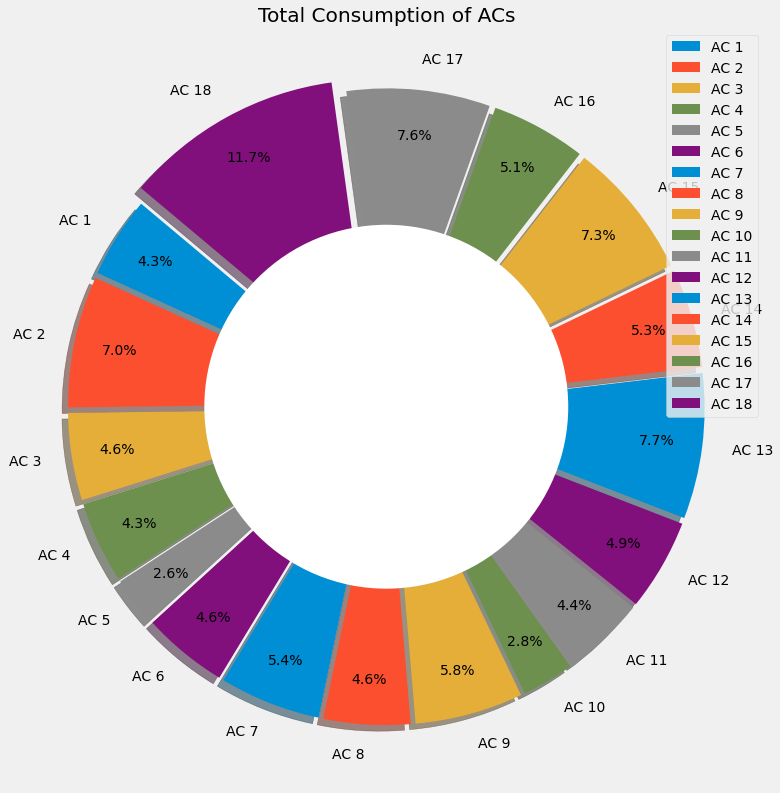

In [59]:
# plt.pie(Total_years_consum['Consumption'],labels=Total_years_consum['AC'], explode = pull)
# circle = plt.Circle( (0,0), 0.7, color='white')
# p=plt.gcf()
# p.gca().add_artist(circle)
# plt.show()
plt.figure(figsize=(15,13))
plt.style.use('fivethirtyeight')
explode = (0.05, 0.05, 0.05, 0.05, 0.05,0.05, 0.05, 0.05, 0.05, 0.05,0.05, 0.05, 0.05, 0.05, 0.05,0.05, 0.05, 0.09)
  
# Pie Chart
plt.pie(Total_years_consum['Consumption'],labels=Total_years_consum['AC'],
        autopct='%1.1f%%', pctdistance=0.85,shadow=True, startangle=140,
        explode=explode)
  
# draw circle
centre_circle = plt.Circle((0, 0), 0.60, fc='white')
fig = plt.gcf()
  
# Adding Circle in Pie chart
fig.gca().add_artist(centre_circle)
  
# Adding Title of chart
plt.title('Total Consumption of ACs')
plt.legend(Total_years_consum['AC'], loc="upper right")
# Displaing Chart
plt.show()

####**AC 18's  total consumption is more so it is used  more frequently.**

####**Whereas the consumption of  AC 5 is less,  as it  is used less frequently.**

In [ ]:
df4 = df2.copy()

In [ ]:
 df4['Date'] = pd.to_datetime(df4[["year", "month", "day"]])

In [ ]:
df5 = df4[['AC 1', 'AC 2', 'AC 3', 'AC 4', 'AC 5', 'AC 6', 'AC 7', 'AC 8',
       'AC 9', 'AC 10', 'AC 11', 'AC 12', 'AC 13', 'AC 14', 'AC 15', 'AC 16',
       'AC 17', 'AC 18','Date']]

In [ ]:
df5.head()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,Date
0,7.518632,8.788315,0.0,0.0,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981,2019-08-01
2,7.426114,8.940615,0.0,0.0,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500,2019-08-01
4,7.052986,9.161103,0.0,0.0,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475,2019-08-01
6,6.665446,9.065626,0.0,0.0,2.575639,3.772891,2.596200,5.805132,3.553778,1.878356,2.737645,2.510972,3.090007,2.666604,4.607439,3.062610,3.063953,6.127366,2019-08-01
8,6.674838,9.096130,0.0,0.0,2.021472,3.155697,2.845417,6.315060,3.042244,1.914650,2.452500,2.171791,3.097202,2.710572,5.332696,2.640150,2.864680,5.662474,2019-08-01


In [ ]:
fig=go.Figure()
fig.add_trace(go.Scatter(x=df5['Date'], y=df5['AC 1'],
                         mode='lines',
                         name='AC 1'))
fig.add_trace(go.Scatter(x=df5['Date'], y=df5['AC 2'],
                         mode='lines',
                         name='AC 2'))
fig.add_trace(go.Scatter(x=df5['Date'], y=df5['AC 3'],
                         mode='lines',
                         name='AC 3'))
fig.add_trace(go.Scatter(x=df5['Date'], y=df5['AC 4'],
                         mode='lines',
                         name='AC 4'))
fig.add_trace(go.Scatter(x=df5['Date'], y=df5['AC 5'],
                         mode='lines',
                         name='AC 5'))
fig.add_trace(go.Scatter(x=df5['Date'], y=df5['AC 6'],
                         mode='lines',
                         name='AC 6'))
fig.add_trace(go.Scatter(x=df5['Date'], y=df5['AC 7'],
                         mode='lines',
                         name='AC 7'))
fig.add_trace(go.Scatter(x=df5['Date'], y=df5['AC 8'],
                         mode='lines',
                         name='AC 8'))
# fig.add_trace(go.Scatter(x=df5['Date'], y=df5['AC 9'],
#                          mode='lines',
#                          name='AC 9'))
# fig.add_trace(go.Scatter(x=df5['Date'], y=df5['AC 10'],
#                          mode='lines',
#                          name='AC 10'))
# fig.add_trace(go.Scatter(x=df5['Date'], y=df5['AC 11'],
#                          mode='lines',
#                          name='AC 11'))
# fig.add_trace(go.Scatter(x=df5['Date'], y=df5['AC 12'],
#                          mode='lines',
#                          name='AC 12'))
# fig.add_trace(go.Scatter(x=df5['Date'], y=df5['AC 13'],
#                          mode='lines',
#                          name='AC 13'))
# fig.add_trace(go.Scatter(x=df5['Date'], y=df5['AC 14'],
#                          mode='lines',
#                          name='AC 14'))
# fig.add_trace(go.Scatter(x=df5['Date'], y=df5['AC 15'],
#                          mode='lines',
#                          name='AC 15'))
# fig.add_trace(go.Scatter(x=df5['Date'], y=df5['AC 16'],
#                          mode='lines',
#                          name='AC 16'))
# fig.add_trace(go.Scatter(x=df5['Date'], y=df5['AC 17'],
#                          mode='lines',
#                          name='AC 17'))
# fig.add_trace(go.Scatter(x=df5['Date'], y=df5['AC 18'],
#                          mode='lines',
#                          name='AC 18'))
fig.update_layout(title='Power Consumption')
iplot(fig)

**Power Consumption Trend**(displayed first 8 AC's) 

In [ ]:
fig=go.Figure()
fig.add_trace(go.Scatter(x=df5['Date'], y=df5['AC 18'],
                         mode='lines+markers',
                         name='AC 18'))
fig.add_trace(go.Scatter(x=df5['Date'], y=df5['AC 5'],
                         mode='lines+markers',
                         name='AC 5'))
fig.update_layout(title='AC18  & AC5')
iplot(fig)

**AC 18 -Overall Highest Consumption**

**AC 5 -Overall Lowest Consumption**

**Above  graph shows the usage pattern of both the AC's during August & September**

In [ ]:
# df6= df5[['AC 1', 'AC 2', 'AC 3', 'AC 4', 'AC 5', 'AC 6', 'AC 7', 'AC 8', 'AC 9',
#        'AC 10', 'AC 11', 'AC 12', 'AC 13', 'AC 14', 'AC 15', 'AC 16', 'AC 17',
#        'AC 18', 'Date']]

# df6 = df5.set_index('Date')
# bcr.bar_chart_race(df6, figsize=(4, 3.5),period_length =500,filename = None, title='power usage by states')

In [ ]:
# monthly_df = df_long.groupby([df_long.Dates.dt.year, df_long.Dates.dt.month,df_long.States,df_long.Regions, df_long.latitude,df_long.longitude])['Usage'].mean()
# monthly_df.index = monthly_df.index.set_names(['year', 'month','State','Region','latitude','longitude'])
# monthly_df = monthly_df.reset_index()
# monthly_df['month'] = monthly_df['month'].apply(lambda x: calendar.month_abbr[x])

In [ ]:
#monthly_df = df5.groupby([df5.Dates.dt.month])[]

In [ ]:
df7 = df4[['AC 1', 'AC 2', 'AC 3', 'AC 4', 'AC 5', 'AC 6', 'AC 7', 'AC 8',
       'AC 9', 'AC 10', 'AC 11', 'AC 12', 'AC 13', 'AC 14', 'AC 15', 'AC 16',
       'AC 17', 'AC 18','month']]

In [ ]:
df7['Total_day_consum'] =  df3[['Total_row']]

In [ ]:
df7.tail()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,month,Total_day_consum
87831,0.000000,6.089533,2.322677,1.422932,0.000000,0.000000,3.729901,3.747301,3.578350,1.714157,5.146438,3.253012,2.464426,2.829701,3.693877,1.992432,3.029462,7.202612,9,52.216810
87833,0.000000,6.046765,2.195754,1.861175,0.813454,0.000000,3.666080,3.017628,3.600397,1.547953,4.379771,3.144666,3.045807,2.693068,4.090679,1.944854,3.048858,7.348333,9,52.445240
87835,0.000000,6.122385,2.192198,2.083315,1.046250,0.000000,3.668421,3.006311,3.614301,1.860847,5.019769,3.154221,3.648026,2.439526,4.062719,1.854352,3.027539,7.259989,9,54.060166
87837,1.209176,6.152532,2.211421,0.000000,1.448103,0.000000,3.151248,2.871690,3.417942,2.185493,5.174168,2.772349,3.786657,2.060023,4.057525,1.870886,2.991946,7.134647,9,52.495807
87839,1.430442,6.078281,1.891162,0.000000,1.577491,4.364239,3.126339,3.287224,3.986978,2.013912,4.821829,3.363855,3.380110,1.949240,4.026304,1.862166,3.009434,7.179719,9,57.348726


####**Grouping the data monthwise** 

In [ ]:
monthly_df = df7.groupby([df7['month']])['Total_day_consum'].mean()

In [ ]:
monthly_df.index = monthly_df.index.set_names(['Months'])
monthly_df = monthly_df.reset_index()
monthly_df['Months'] = monthly_df['Months'].apply(lambda x: calendar.month_abbr[x])

In [ ]:
monthly_df

,Months,Total_day_consum
0,Aug,55.329152
1,Sep,55.107236


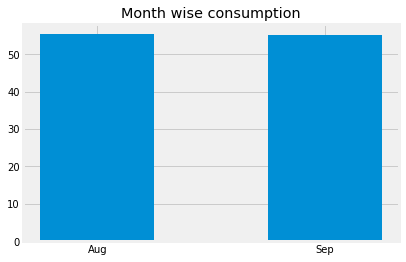

In [ ]:
plt.bar('Months','Total_day_consum',data=monthly_df,width=0.5)
plt.title('Month wise consumption');

####**In the month of August,average single day power consumption is 55.329**
####**whereas in the month of september avg. power comsumption was 55.107**


####**Filtering the data according months**

In [ ]:
month_aug= df7.month ==8
month_sep= df7.month==9
m_aug = df7[month_aug]
m_sep= df7[month_sep]

In [ ]:
m_aug1= m_aug[['AC 1', 'AC 2', 'AC 3', 'AC 4', 'AC 5', 'AC 6', 'AC 7', 'AC 8', 'AC 9',
       'AC 10', 'AC 11', 'AC 12', 'AC 13', 'AC 14', 'AC 15', 'AC 16', 'AC 17',
       'AC 18']]

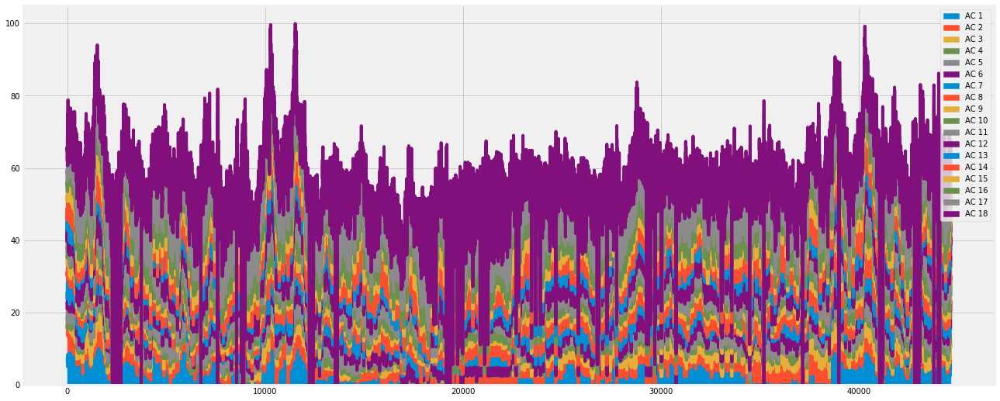

In [ ]:
plt.rcParams["figure.figsize"] = (20,9)
m_aug1.plot.area();

**Area Plot for visualizing the changes over time for the AC's**

In [ ]:
m_aug_bar = m_aug.copy()
m_sep_bar = m_sep.copy()

In [ ]:
m_aug_bar.drop(['Total_day_consum'],axis=1,inplace=True)
m_sep_bar.drop(['Total_day_consum'],axis=1,inplace=True)

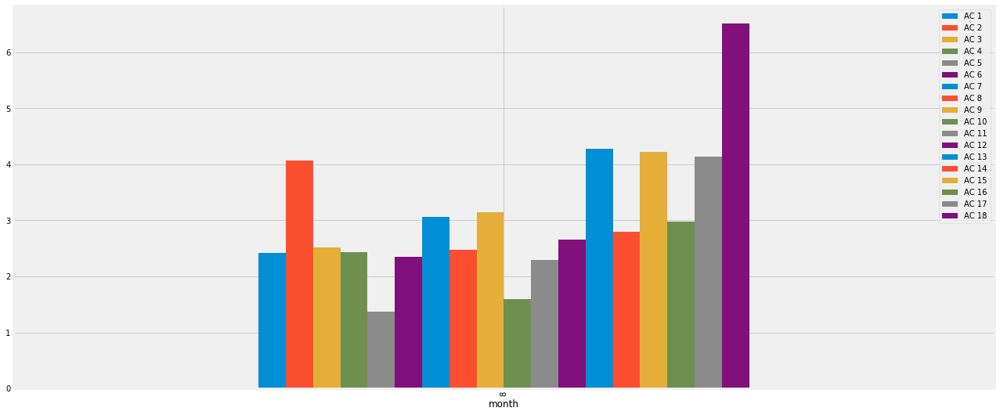

In [ ]:
m_aug_bar.groupby('month').mean().plot.bar()

**Consumptiopn of each AC in the month of August**

1.   AC 18 has highest comsumption rate, followed by AC 13
2.   Least consumption is of AC 5

 

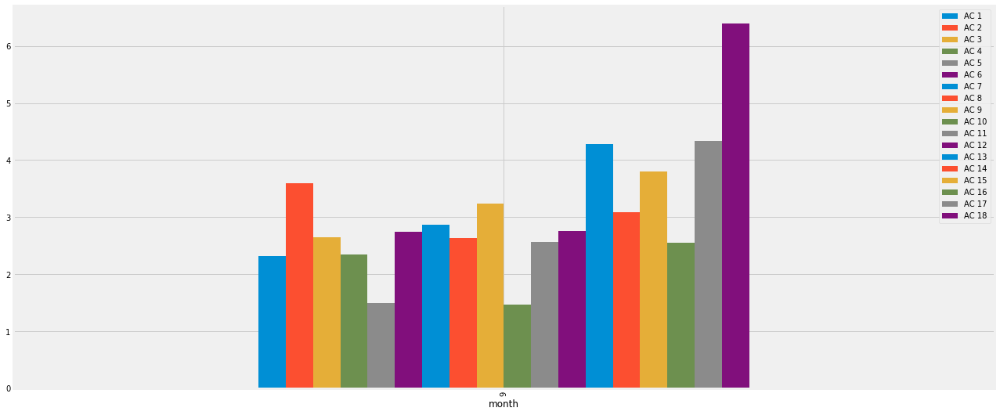

In [ ]:
m_sep_bar.groupby('month').mean().plot.bar()

**Consumptiopn of each AC in the month of Sept**

1.   AC 18 has highest comsumption rate, followed by AC 17
2.   Least consumption is of AC 10

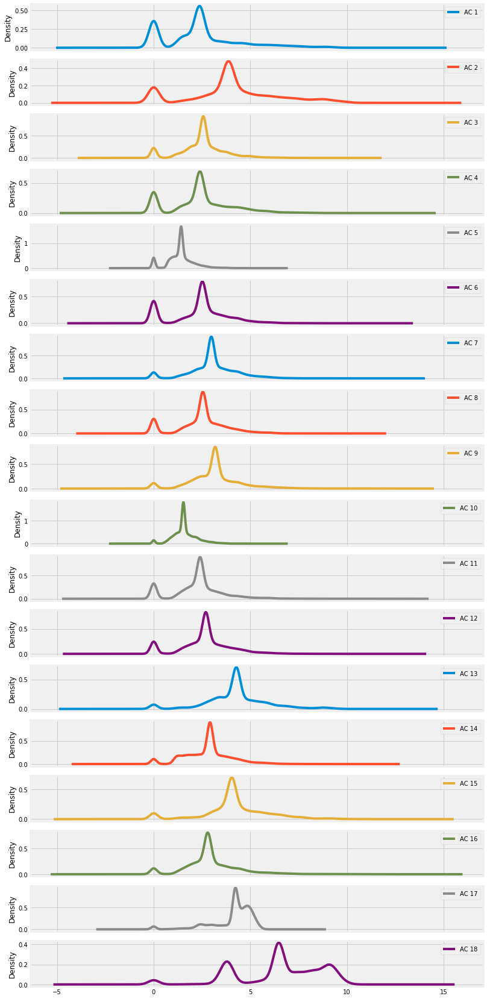

In [ ]:
plt.rcParams["figure.figsize"] = (12,30)
m_aug1.plot.kde(subplots=True);

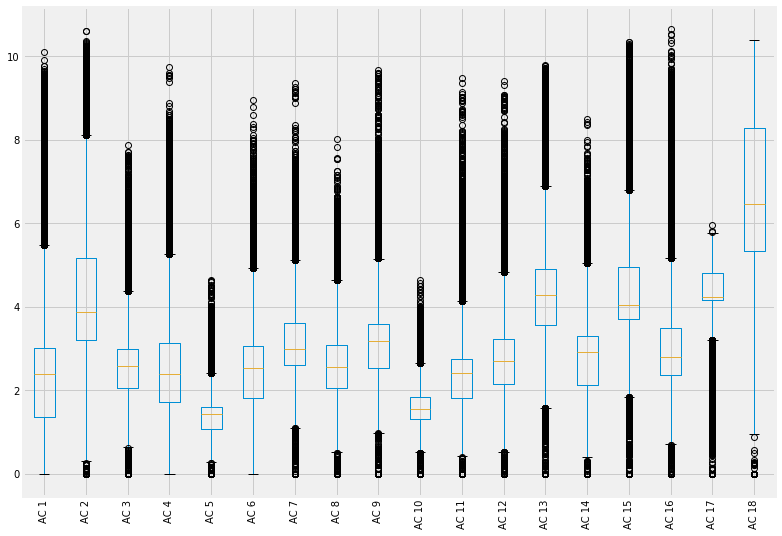

In [ ]:
plt.rcParams["figure.figsize"] = (12,9)
m_aug1.plot.box()
plt.xticks(rotation='vertical');

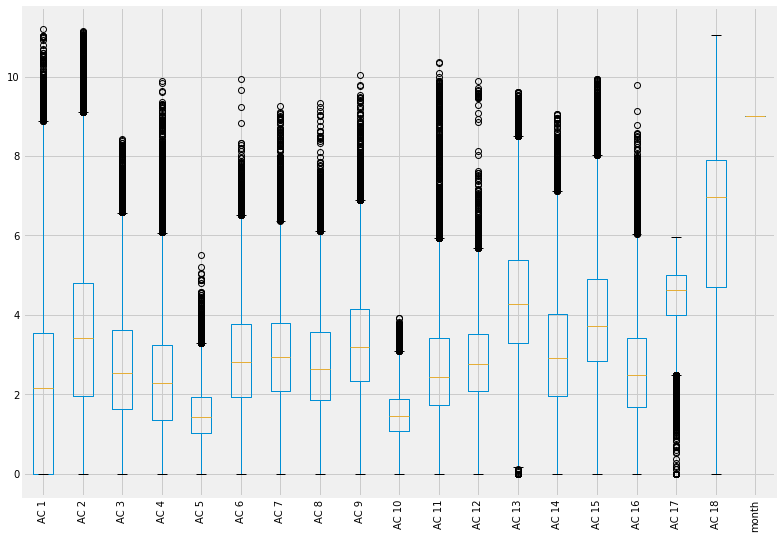

In [ ]:
plt.rcParams["figure.figsize"] = (12,9)
m_sep_bar.plot.box()
plt.xticks(rotation='vertical');

####**Temperature Dataset of New Delhi**

In [ ]:
temp = pd.read_csv(r'/content/drive/MyDrive/history_data.csv')

In [ ]:
temp.columns

Index(['Name', 'Date time', 'Maximum Temperature', 'Minimum Temperature',
       'Temperature', 'Wind Chill', 'Heat Index', 'Precipitation', 'Snow',
       'Snow Depth', 'Wind Speed', 'Wind Direction', 'Wind Gust', 'Visibility',
       'Cloud Cover', 'Relative Humidity', 'Conditions'],
      dtype='object')

In [ ]:
temp= temp[['Date time','Temperature']]

In [ ]:
temp.isnull().sum()

Date time      0
Temperature    0
dtype: int64

In [ ]:
df8= df4.copy()

In [ ]:
df8 = df8[['AC 1', 'AC 2', 'AC 3', 'AC 4', 'AC 5', 'AC 6', 'AC 7', 'AC 8',
       'AC 9', 'AC 10', 'AC 11', 'AC 12', 'AC 13', 'AC 14', 'AC 15', 'AC 16',
       'AC 17', 'AC 18','Date']]

In [ ]:
grp_df = df8.groupby([df8['Date']])['AC 1', 'AC 2', 'AC 3', 'AC 4', 'AC 5', 'AC 6', 'AC 7', 'AC 8',
       'AC 9', 'AC 10', 'AC 11', 'AC 12', 'AC 13', 'AC 14', 'AC 15', 'AC 16',
       'AC 17', 'AC 18'].sum()

###**Grouping the data according to the Date**

In [ ]:
grp_df.head()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18
Date,,,,,,,,,,,,,,,,,,
2019-08-01,3104.309104,5178.653314,1630.817266,2381.389342,1038.723005,2015.883705,1876.576564,2345.536218,1630.195759,1268.278059,1293.709787,1828.139131,3395.862134,2206.327511,3094.283539,2606.588417,3342.032865,5443.447364
2019-08-02,2863.178470,3597.450869,2091.891051,2271.603933,1179.660734,1685.658280,1678.985550,1068.449478,1895.803388,1270.551426,1446.033735,2011.115215,3687.542111,1693.435960,3215.312132,2476.811557,3197.280871,5603.260664
2019-08-03,2342.643465,3088.342550,2109.504047,1371.246305,988.236206,1839.578327,2291.289651,929.933265,1984.173792,1053.643206,1567.961997,2216.409623,3462.219935,1343.878868,3214.434392,2109.495541,3156.424193,5674.478038
2019-08-04,2952.737145,3138.325802,1849.015820,1113.272698,1099.236903,2551.196594,2014.250945,1118.643663,1797.288012,1213.929622,1311.968897,2175.115602,3532.554241,1585.776477,3311.702820,2060.793242,3221.021199,5914.380031
2019-08-05,2544.364159,2887.718742,1285.868449,654.766925,1203.978429,2731.833220,1790.925288,1182.123289,1869.045967,1028.159330,2412.924481,2239.945172,3012.306442,2011.984857,3601.304366,2495.989964,2749.299468,4406.932052


In [ ]:
grp_df= grp_df.reset_index()

In [ ]:
temp.head()

,Date time,Temperature
0,08/01/2019,89.5
1,08/02/2019,86.3
2,08/03/2019,84.6
3,08/04/2019,86.0
4,08/05/2019,87.6


In [ ]:
temp['Date time'] = pd.to_datetime(temp['Date time'])
temp['Date'] = temp['Date time'].dt.strftime('%Y/%m/%d')
temp.drop(['Date time'],axis=1,inplace=True)
temp['Date'] = pd.to_datetime(temp['Date'])

####**Merging the Power Consumption Data and New Delhi Temperature data on Date Column**

In [ ]:
ext_temp = pd.merge(temp,grp_df,how='outer',on='Date')

In [ ]:
ext_temp.head()

,Temperature,Date,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18
0,89.5,2019-08-01,3104.309104,5178.653314,1630.817266,2381.389342,1038.723005,2015.883705,1876.576564,2345.536218,1630.195759,1268.278059,1293.709787,1828.139131,3395.862134,2206.327511,3094.283539,2606.588417,3342.032865,5443.447364
1,86.3,2019-08-02,2863.178470,3597.450869,2091.891051,2271.603933,1179.660734,1685.658280,1678.985550,1068.449478,1895.803388,1270.551426,1446.033735,2011.115215,3687.542111,1693.435960,3215.312132,2476.811557,3197.280871,5603.260664
2,84.6,2019-08-03,2342.643465,3088.342550,2109.504047,1371.246305,988.236206,1839.578327,2291.289651,929.933265,1984.173792,1053.643206,1567.961997,2216.409623,3462.219935,1343.878868,3214.434392,2109.495541,3156.424193,5674.478038
3,86.0,2019-08-04,2952.737145,3138.325802,1849.015820,1113.272698,1099.236903,2551.196594,2014.250945,1118.643663,1797.288012,1213.929622,1311.968897,2175.115602,3532.554241,1585.776477,3311.702820,2060.793242,3221.021199,5914.380031
4,87.6,2019-08-05,2544.364159,2887.718742,1285.868449,654.766925,1203.978429,2731.833220,1790.925288,1182.123289,1869.045967,1028.159330,2412.924481,2239.945172,3012.306442,2011.984857,3601.304366,2495.989964,2749.299468,4406.932052


In [ ]:
ext_temp1 = ext_temp.copy()

In [ ]:
ext_temp1['Total'] = ext_temp1[['AC 1', 'AC 2', 'AC 3', 'AC 4', 'AC 5', 'AC 6', 'AC 7', 'AC 8', 'AC 9',
       'AC 10', 'AC 11', 'AC 12', 'AC 13', 'AC 14', 'AC 15', 'AC 16', 'AC 17',
       'AC 18']].sum(axis=1)

In [ ]:
ext_temp1.drop(['Date'],axis=1,inplace=True)

In [ ]:
import plotly.express as px

fig = px.scatter(ext_temp1, x="Temperature", y="Total", marginal_y="violin",
           marginal_x="box", trendline="ols", template="simple_white")
fig.show()

####**We can see the trend of Power Consumption and Temperature(outside temp of gurgaon).**
####**As the temperature has risen the consumption has also increased.**



In [ ]:
pred_df = ext_temp[['Date']]
pred_df['Total'] =  ext_temp1[['Total']]

In [ ]:
pred_df

,Date,Total
0,2019-08-01,45680.753084
1,2019-08-02,42934.025425
2,2019-08-03,40743.893402
3,2019-08-04,41961.209712
4,2019-08-05,40109.470602
5,2019-08-06,37441.330406
6,2019-08-07,36493.828181
7,2019-08-08,49844.880950
8,2019-08-09,41281.933038
9,2019-08-10,37671.204540


In [ ]:
pred_df.set_index('Date',inplace=True)

In [ ]:
pred_df.head()

,Total
Date,
2019-08-01,45680.753084
2019-08-02,42934.025425
2019-08-03,40743.893402
2019-08-04,41961.209712
2019-08-05,40109.470602


In [ ]:
pred_df.describe()

,Total
count,61.000000
mean,47066.362446
std,15292.697314
min,28707.631279
25%,37356.216769
50%,41526.523674
75%,48431.534565
max,84045.758255


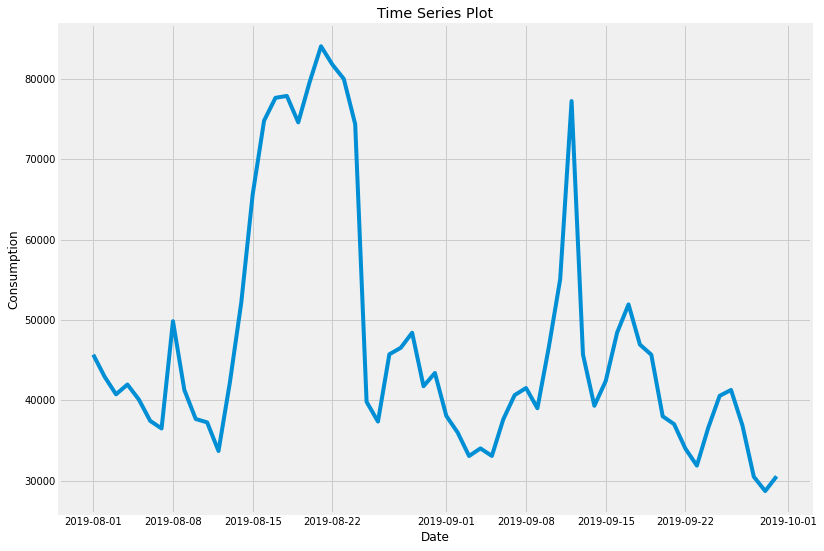

In [ ]:
plt.rcParams["figure.figsize"] = (12,9)
plt.xlabel("Date")
plt.ylabel("Consumption")
plt.title("Time Series Plot")
plt.plot(pred_df)

####**Forecast of Power Consumption**
####**Using SARIMAX model**

In [ ]:
pred_df.head()

,Total
Date,
2019-08-01,45680.753084
2019-08-02,42934.025425
2019-08-03,40743.893402
2019-08-04,41961.209712
2019-08-05,40109.470602


In [ ]:
pred_df['first_shift'] = pred_df['Total'] - pred_df['Total'].shift(1)

NameError: ignored

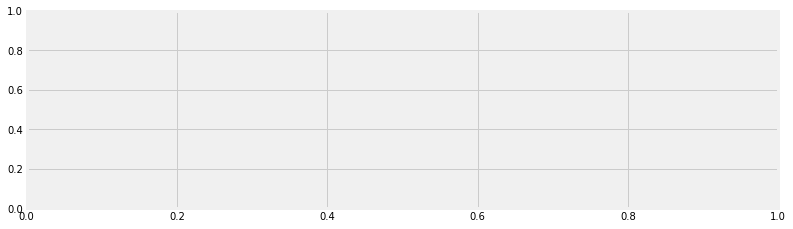

In [ ]:
fig = plt.figure(figsize=(12,8))
ax1= fig.add_subplot(211)
fig = plot_acf(pred_df['first_shift'].iloc[2:],lags=30,ax=ax1)
ax2= fig.add_subplot(212)
fig= plot_pacf(pred_df['first_shift'].iloc[2:],lags=30,ax=ax2)

In [ ]:
pred_df.head()

,Total,first_shift
Date,,
2019-08-01,45680.753084,NaN
2019-08-02,42934.025425,-2746.727660
2019-08-03,40743.893402,-2190.132022
2019-08-04,41961.209712,1217.316310
2019-08-05,40109.470602,-1851.739111


In [ ]:
# from statsmodels.tsa.stattools import adfuller
# def adfuller_test(Total):
#   result = adfuller(Total)
#   labels= ['ADF test statistics','p-value','Lags used','Numberof obs used']

#   for value,label in zip(result,labels):
#     print('{}:{}'.format(label,value))
#   if result[1]<=0.05:
#     print('Strong evidence against null hypo,reject the nullhypo,& data is stationary')
#   else:
#     print('Weak evidence against null hypo,accept the nullhypo,& data is not stationary')
  

**To check if our datais stationary or not.**

**As the p-value is less than 0.5,  datais  not stationary**

In [ ]:
#adfuller_test(pred_df['Total'])

In [ ]:
import statsmodels.api as sm
model =  sm.tsa.statespace.SARIMAX(pred_df['Total'],order=(2,1,4),seasonal_order=(2,1,4,3))
results = model.fit()
pred_df['forecast']= results.predict(start=3,end=61,dynamic=True)

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:512: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



In [ ]:
pred_df

,Total,first_shift,forecast
Date,,,
2019-08-01,45680.753084,NaN,NaN
2019-08-02,42934.025425,-2746.727660,NaN
2019-08-03,40743.893402,-2190.132022,NaN
2019-08-04,41961.209712,1217.316310,69356.314899
2019-08-05,40109.470602,-1851.739111,65745.928057
2019-08-06,37441.330406,-2668.140196,66685.462977
2019-08-07,36493.828181,-947.502225,92231.229886
2019-08-08,49844.880950,13351.052769,94537.188233
2019-08-09,41281.933038,-8562.947912,95070.795798


In [ ]:
pred_df1 = pred_df.copy()

In [ ]:
pred_df1 = pred_df1.reset_index()

####**Forecasted Power Consumption in Below DataFrame**

In [ ]:
pred_df1.head(20)

,Date,Total,first_shift,forecast
0,2019-08-01,45680.753084,NaN,NaN
1,2019-08-02,42934.025425,-2746.727660,NaN
2,2019-08-03,40743.893402,-2190.132022,NaN
3,2019-08-04,41961.209712,1217.316310,69356.314899
4,2019-08-05,40109.470602,-1851.739111,65745.928057
5,2019-08-06,37441.330406,-2668.140196,66685.462977
6,2019-08-07,36493.828181,-947.502225,92231.229886
7,2019-08-08,49844.880950,13351.052769,94537.188233
8,2019-08-09,41281.933038,-8562.947912,95070.795798
9,2019-08-10,37671.204540,-3610.728497,117184.270474
